<a href="https://colab.research.google.com/github/pejmanS21/GAN_Collections/blob/main/StyleGAN_NVIDIA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# StyleGAN2 Morph Between Two REAL Images

This notebook allows you to choose a starting and ending image and use StyleGAN2 to produce a "morph" video between the two pictures.

**You must use `GPU` so go to "*Runtme>>change runtime type>>Hardware accelerator*" then select GPU**

Based on [Jeff Heaton](https://www.youtube.com/channel/UCR1-GEpyOPzT2AO4D_eifdw) YouTube Channel

In [ ]:
NETWORK = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"
STEPS = 200
FPS = 30
FREEZE_STEPS = 30

# Source Image

upload source image to begin with

In [ ]:
import os
from google.colab import files

uploaded = files.upload()

if len(uploaded) != 1:
  print("Upload exactly 1 file for source.")
else:
  for k, v in uploaded.items():
    _, ext = os.path.splitext(k)
    os.remove(k)
    SOURCE_NAME = f"source{ext}"
    open(SOURCE_NAME, 'wb').write(v)

Saving avengers-endgame-8-1556026980.jpeg to avengers-endgame-8-1556026980.jpeg


# Target Image

upload target_image to ends with

In [ ]:
uploaded = files.upload()

if len(uploaded) != 1:
  print("Upload exactly 1 file for target.")
else:
  for k, v in uploaded.items():
    _, ext = os.path.splitext(k)
    os.remove(k)
    TARGET_NAME = f"target{ext}"
    open(TARGET_NAME, 'wb').write(v)

Saving 7c51a6800b4fd5e22fbb34311d0052734f995765.webp to 7c51a6800b4fd5e22fbb34311d0052734f995765.webp


# Install Software

Some software must be installed into Colab, for this notebook to work.

In [ ]:
!wget http://dlib.net/files/shape_predictor_5_face_landmarks.dat.bz2
!bzip2 -d shape_predictor_5_face_landmarks.dat.bz2

--2022-03-10 09:13:50--  http://dlib.net/files/shape_predictor_5_face_landmarks.dat.bz2
Resolving dlib.net (dlib.net)... 107.180.26.78
Connecting to dlib.net (dlib.net)|107.180.26.78|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5706710 (5.4M)
Saving to: ‘shape_predictor_5_face_landmarks.dat.bz2’

shape_predictor_5_f 100%[===================>]   5.44M  13.2MB/s    in 0.4s    

2022-03-10 09:13:51 (13.2 MB/s) - ‘shape_predictor_5_face_landmarks.dat.bz2’ saved [5706710/5706710]



In [ ]:
import sys

!git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git
!pip install ninja
sys.path.insert(0, "/content/stylegan2-ada-pytorch")

Cloning into 'stylegan2-ada-pytorch'...
remote: Enumerating objects: 128, done.
remote: Total 128 (delta 0), reused 0 (delta 0), pack-reused 128
Receiving objects: 100% (128/128), 1.12 MiB | 7.36 MiB/s, done.
Resolving deltas: 100% (57/57), done.
     |████████████████████████████████| 108 kB 5.0 MB/s 


# Preprocess Images for Best StyleGAN Results

The following are helper functions for the preprocessing.
Get face from image and size correction.

In [ ]:
import cv2
import numpy as np
from PIL import Image
import dlib

detector = dlib.get_frontal_face_detector()
predictor = dlib.shape_predictor('shape_predictor_5_face_landmarks.dat')

def find_eyes(img):
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  rects = detector(gray, 0)
  
  if len(rects) == 0:
    raise ValueError("No faces detected")
  elif len(rects) > 1:
    raise ValueError("Multiple faces detected")

  shape = predictor(gray, rects[0])
  features = []

  for i in range(0, 5):
    features.append((i, (shape.part(i).x, shape.part(i).y)))

  return (int(features[3][1][0] + features[2][1][0]) // 2, \
    int(features[3][1][1] + features[2][1][1]) // 2), \
    (int(features[1][1][0] + features[0][1][0]) // 2, \
    int(features[1][1][1] + features[0][1][1]) // 2)

def crop_stylegan(img):
  left_eye, right_eye = find_eyes(img)
  d = abs(right_eye[0] - left_eye[0])
  z = 255/d
  ar = img.shape[0]/img.shape[1]
  w = img.shape[1] * z
  img2 = cv2.resize(img, (int(w), int(w*ar)))
  bordersize = 1024
  img3 = cv2.copyMakeBorder(
      img2,
      top=bordersize,
      bottom=bordersize,
      left=bordersize,
      right=bordersize,
      borderType=cv2.BORDER_REPLICATE)

  left_eye2, right_eye2 = find_eyes(img3)

  crop1 = left_eye2[0] - 385 
  crop0 = left_eye2[1] - 490
  return img3[crop0:crop0+1024,crop1:crop1+1024]

# Visualization


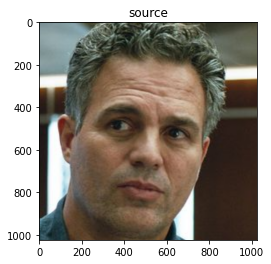

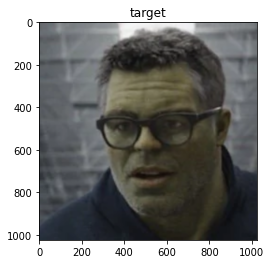

True

In [ ]:
from matplotlib import pyplot as plt
import cv2

image_source = cv2.imread(SOURCE_NAME)
if image_source is None:
    raise ValueError("Source image not found")

image_target = cv2.imread(TARGET_NAME)
if image_target is None:
    raise ValueError("Source image not found")

cropped_source = crop_stylegan(image_source)
cropped_target = crop_stylegan(image_target)

img = cv2.cvtColor(cropped_source, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.title('source')
plt.show()

img = cv2.cvtColor(cropped_target, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.title('target')
plt.show()

cv2.imwrite("cropped_source.png", cropped_source)
cv2.imwrite("cropped_target.png", cropped_target)

#print(find_eyes(cropped_source))
#print(find_eyes(cropped_target))

# Convert Source to a GAN

First, we convert the source to a GAN latent vector.  This process will take several minutes.<br>
You can change **--num-steps**.

In [ ]:
cmd = f"python /content/stylegan2-ada-pytorch/projector.py --save-video 0 --num-steps 1500 --outdir=out_source --target=cropped_source.png --network={NETWORK}"
!{cmd}

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"...
Computing W midpoint and stddev using 10000 samples...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
step    1/1500: dist 0.58 loss 24569.47
step    2/1500: dist 0.62 loss 27642.85
step    3/1500: dist 0.59 loss 27324.28
step    4/1500: dist 0.59 loss 26703.27
step    5/1500: dist 0.59 loss 25808.49
step    6/1500: dist 0.60 loss 24676.50
step    7/1500: dist 0.59 loss 23347.97
step    8/1500: dist 0.61 loss 21857.59
step    9/1500: dist 0.67 loss 20235.28
step   10/1500: dist 0.58 loss 18518.64
step   11/1500: dist 0.59 loss 16744.54
step   12/1500: dist 0.62 loss 14939.49
step   13/1500: dist 0.58 loss 13141.08
step   14/1500: dist 0.58 loss 11384.70
step   15/1500: dist 0.58 loss 9690.72
step   16/1500: dist 0.54 loss 8086.62
step   17/1500: dist 0.63 loss 6604.88
step   18/1500: dist 0.63 loss 5288.57
step   19/1500: dist

# Convert Target to a GAN

Next, we convert the target to a GAN latent vector.  This process will also take several minutes.<br>
You can change **--num-steps**.

In [ ]:
cmd = f"python /content/stylegan2-ada-pytorch/projector.py --save-video 0 --num-steps 1500 --outdir=out_target --target=cropped_target.png --network={NETWORK}"
!{cmd}

Loading networks from "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"...
Computing W midpoint and stddev using 10000 samples...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.
step    1/1500: dist 0.71 loss 24569.60
step    2/1500: dist 0.76 loss 27642.98
step    3/1500: dist 0.71 loss 27324.39
step    4/1500: dist 0.68 loss 26703.36
step    5/1500: dist 0.70 loss 25808.60
step    6/1500: dist 0.74 loss 24676.64
step    7/1500: dist 0.68 loss 23348.06
step    8/1500: dist 0.69 loss 21857.67
step    9/1500: dist 0.76 loss 20235.38
step   10/1500: dist 0.63 loss 18518.69
step   11/1500: dist 0.70 loss 16744.65
step   12/1500: dist 0.69 loss 14939.56
step   13/1500: dist 0.66 loss 13141.17
step   14/1500: dist 0.67 loss 11384.79
step   15/1500: dist 0.67 loss 9690.81
step   16/1500: dist 0.64 loss 8086.73
step   17/1500: dist 0.63 loss 6604.88
step   18/1500: dist 0.68 loss 5288.62
step   19/1500: dist

# visualize 2 GANs

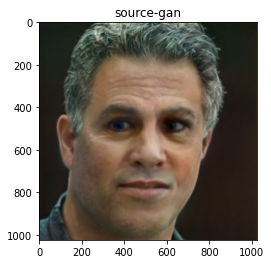

In [ ]:
img_gan_source = cv2.imread('/content/out_source/proj.png')
img = cv2.cvtColor(img_gan_source, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.title('source-gan')
plt.show()

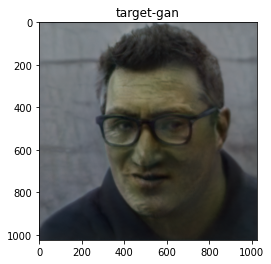

In [ ]:
img_gan_target = cv2.imread('/content/out_target/proj.png')
img = cv2.cvtColor(img_gan_target, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.title('target-gan')
plt.show()

# Build the Video

The following code builds a transition video between the two latent vectors previously obtained.

In [ ]:
import torch
import dnnlib
import legacy
import PIL.Image
import numpy as np
import imageio
from tqdm.notebook import tqdm

lvec1 = np.load('/content/out_source/projected_w.npz')['w']
lvec2 = np.load('/content/out_target/projected_w.npz')['w']

network_pkl = "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/ffhq.pkl"
device = torch.device('cuda')
with dnnlib.util.open_url(network_pkl) as fp:
    G = legacy.load_network_pkl(fp)['G_ema'].requires_grad_(False).to(device) # type: ignore

diff = lvec2 - lvec1
step = diff / STEPS
current = lvec1.copy()
target_uint8 = np.array([1024, 1024, 3], dtype=np.uint8)

video = imageio.get_writer('/content/Banner_Hulk.mp4', mode='I', fps=FPS, codec='libx264', bitrate='16M')

for j in tqdm(range(STEPS)):
  z = torch.from_numpy(current).to(device)
  synth_image = G.synthesis(z, noise_mode='const')
  synth_image = (synth_image + 1) * (255 / 2)
  synth_image = synth_image.permute(0, 2, 3, 1).clamp(0, 255).to(torch.uint8)[0].cpu().numpy()

  repeat = FREEZE_STEPS if j==0 or j==(STEPS-1) else 1
   
  for i in range(repeat):
    video.append_data(synth_image)
  current = current + step


video.close()

  0%|          | 0/200 [00:00<?, ?it/s]

Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "upfirdn2d_plugin"... Done.


In [ ]:
from IPython.display import HTML
from base64 import b64encode

mp4 = open('Banner_Hulk.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

In [ ]:
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [ ]:
from google.colab import files
files.download("movie.mp4") 